In [2]:
import os
import numpy as np # type: ignore
import pandas as pd # type: ignore
from keras.utils import to_categorical # type: ignore
from keras.preprocessing.sequence import pad_sequences # type: ignore
from preprocess import video_to_grayscale, video_to_grayscale_extract_frames
from msdcnn import feature_fusion
from lstmFC import reshape_to_3d
from lstmFC import lstm
from tensorflow.keras.models import load_model # type: ignore

In [3]:
def load_data(data_path,numframes):
    x = []
    y = []
    for folder in ["Original", "Forged"]:
        folder_path = os.path.join(data_path, folder)
        for filename in os.listdir(folder_path):
            video_path = os.path.join(folder_path, filename)
            preprocessed_video = video_to_grayscale_extract_frames(video_path, numframes)
            
            # Check if the video has 100 frames, otherwise skip it
            if len(preprocessed_video) != numframes:
                continue
            
            msd = feature_fusion(preprocessed_video)
            msd_reshaped = reshape_to_3d(msd)
            x.append(msd_reshaped)
            if folder == "Original":
                y.append(0)
            else:
                y.append(1)
    return x, y

In [4]:
train_data_path = "D:/Final_Project/Dataset/ForgeryDataset/Deletion2/Training"
x_train, y_train = load_data(train_data_path,60)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━

In [5]:
test_data_path = "D:/Final_Project/Dataset/ForgeryDataset/Deletion2/Testing"
x_test, y_test = load_data(test_data_path,60)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 283ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━

Convert to arrays

In [6]:
x_train = np.array(x_train)
y_train = np.array(y_train)
x_test = np.array(x_test)
y_test = np.array(y_test)

Model

In [7]:
vfd_model = load_model("C:/Users/Preethi/Documents/InterframeVideoForgeryDetection/models/vfd_model.keras")
vfd_model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
vfd_model.summary()

Model: "functional_25"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_2 (InputLayer)      │ (None, None, 96)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm (LSTM)                     │ (None, 144)            │       138,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 1)              │           145 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 138,961 (542.82 KB)

 Trainable params: 138,961 (542.82 KB)

 Non-trainable params: 0 (0.00 B)

In [8]:
vfd_model.fit(x_train, y_train, epochs=10, batch_size=16, validation_data=(x_test, y_test))

Epoch 1/10
23/23 ━━━━━━━━━━━━━━━━━━━━ 6s 79ms/step - accuracy: 0.5427 - loss: 0.9031 - val_accuracy: 0.5607 - val_loss: 0.6946
Epoch 2/10
23/23 ━━━━━━━━━━━━━━━━━━━━ 1s 53ms/step - accuracy: 0.5597 - loss: 0.6850 - val_accuracy: 0.5047 - val_loss: 0.7100
Epoch 3/10
23/23 ━━━━━━━━━━━━━━━━━━━━ 1s 53ms/step - accuracy: 0.5138 - loss: 0.6937 - val_accuracy: 0.5701 - val_loss: 0.6897
Epoch 4/10
23/23 ━━━━━━━━━━━━━━━━━━━━ 1s 54ms/step - accuracy: 0.5809 - loss: 0.6649 - val_accuracy: 0.5327 - val_loss: 0.6937
Epoch 5/10
23/23 ━━━━━━━━━━━━━━━━━━━━ 1s 53ms/step - accuracy: 0.5790 - loss: 0.6783 - val_accuracy: 0.5514 - val_loss: 0.6921
Epoch 6/10
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - accuracy: 0.5570 - loss: 0.6810 - val_accuracy: 0.5514 - val_loss: 0.6905
Epoch 7/10
23/23 ━━━━━━━━━━━━━━━━━━━━ 1s 53ms/step - accuracy: 0.5721 - loss: 0.6703 - val_accuracy: 0.5421 - val_loss: 0.6935
Epoch 8/10
23/23 ━━━━━━━━━━━━━━━━━━━━ 1s 53ms/step - accuracy: 0.5886 - loss: 0.6765 - val_accuracy: 0.5327 - v

In [9]:
predictions = vfd_model.predict(x_test)

4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 148ms/step


In [10]:
print(predictions)

[[0.27614653]
 [0.35115838]
 [0.3642614 ]
 [0.29228923]
 [0.22316991]
 [0.36518052]
 [0.39517263]
 [0.31415102]
 [0.2545003 ]
 [0.34258553]
 [0.5567849 ]
 [0.31566286]
 [0.2856977 ]
 [0.38625035]
 [0.32767233]
 [0.33478785]
 [0.41687816]
 [0.27584225]
 [0.31863293]
 [0.27506596]
 [0.28953874]
 [0.3088086 ]
 [0.34618852]
 [0.32827675]
 [0.24423069]
 [0.35711253]
 [0.48084524]
 [0.27573973]
 [0.31443074]
 [0.2986462 ]
 [0.33744192]
 [0.24286589]
 [0.36137775]
 [0.29702723]
 [0.38462862]
 [0.31202555]
 [0.37122595]
 [0.29751337]
 [0.2471141 ]
 [0.35758057]
 [0.43225974]
 [0.2842755 ]
 [0.43100718]
 [0.39219463]
 [0.4102063 ]
 [0.2738354 ]
 [0.39748287]
 [0.34514737]
 [0.3109439 ]
 [0.2814376 ]
 [0.39297307]
 [0.26361227]
 [0.30177048]
 [0.344642  ]
 [0.3060827 ]
 [0.34652615]
 [0.3458362 ]
 [0.42438123]
 [0.27588505]
 [0.40227008]
 [0.3211733 ]
 [0.44552094]
 [0.43230698]
 [0.34783056]
 [0.27693683]
 [0.2570301 ]
 [0.30419028]
 [0.3248462 ]
 [0.3832588 ]
 [0.43223083]
 [0.32109016]
 [0.29

In [11]:
print(vfd_model.evaluate(x_test, y_test))

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - accuracy: 0.7216 - loss: 0.5856
[0.7082856297492981, 0.5514018535614014]


Example

In [12]:
vidpath = "D:/Final_Project/Dataset/ForgeryDataset/Insertion/Training/Forged/insertion_train (200).avi"
preprocessed_video = video_to_grayscale(vidpath)
msd = feature_fusion(preprocessed_video)
msd_reshaped = reshape_to_3d(msd)
msd_re = np.array([msd_reshaped])
print(vfd_model.predict(msd_re))

129
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━

In [13]:
vidpath = "D:/Final_Project/Dataset/ForgeryDataset/Insertion/Training/Original/original_train (530).avi"
preprocessed_video = video_to_grayscale(vidpath)
msd = feature_fusion(preprocessed_video)
msd_reshaped = reshape_to_3d(msd)
msd_re = np.array([msd_reshaped])
print(vfd_model.predict(msd_re))

100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━

Load and save model

In [14]:
vfd_model.save("C:/Users/Preethi/Documents/InterframeVideoForgeryDetection/models/vfd_model.keras")

In [31]:
train_data_path1 = "D:/Final_Project/Dataset/ForgeryDataset/Insertion2/Training"
x_train1, y_train1 = load_data(train_data_path1,100)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━

In [32]:
test_data_path1 = "D:/Final_Project/Dataset/ForgeryDataset/Insertion2/Testing"
x_test1, y_test1 = load_data(test_data_path1,100)

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 701ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 243ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
1/1 

In [33]:
x_train1 = np.array(x_train1)
y_train1 = np.array(y_train1)
x_test1 = np.array(x_test1)
y_test1 = np.array(y_test1)

In [34]:
vfd_model = load_model("C:/Users/Preethi/Documents/InterframeVideoForgeryDetection/models/vfd_model.keras")
vfd_model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
#vfd_model.summary()

In [35]:
vfd_model.fit(x_train1, y_train1, epochs=10, batch_size=16, validation_data=(x_test1, y_test1))

Epoch 1/10
25/25 ━━━━━━━━━━━━━━━━━━━━ 6s 102ms/step - accuracy: 0.7468 - loss: 0.5350 - val_accuracy: 0.8083 - val_loss: 0.4468
Epoch 2/10
25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 89ms/step - accuracy: 0.8604 - loss: 0.3539 - val_accuracy: 0.8833 - val_loss: 0.3085
Epoch 3/10
25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 78ms/step - accuracy: 0.9164 - loss: 0.2291 - val_accuracy: 0.9333 - val_loss: 0.2431
Epoch 4/10
25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 76ms/step - accuracy: 0.9756 - loss: 0.1179 - val_accuracy: 0.9667 - val_loss: 0.0816
Epoch 5/10
25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 76ms/step - accuracy: 0.9774 - loss: 0.0663 - val_accuracy: 0.9833 - val_loss: 0.0320
Epoch 6/10
25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 77ms/step - accuracy: 0.9928 - loss: 0.0335 - val_accuracy: 0.9667 - val_loss: 0.0718
Epoch 7/10
25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 81ms/step - accuracy: 0.9843 - loss: 0.0333 - val_accuracy: 0.9750 - val_loss: 0.0463
Epoch 8/10
25/25 ━━━━━━━━━━━━━━━━━━━━ 2s 76ms/step - accuracy: 0.9868 - loss: 0.0306 - val_accuracy: 1.0000 - 

In [36]:
predictions = vfd_model.predict(x_test1)
print(predictions)

4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 162ms/step
[[0.00175206]
 [0.00271765]
 [0.00213981]
 [0.06565629]
 [0.00132813]
 [0.00191851]
 [0.0024814 ]
 [0.03298872]
 [0.01077814]
 [0.00161088]
 [0.01303304]
 [0.00151756]
 [0.00968071]
 [0.00583706]
 [0.00159506]
 [0.00148283]
 [0.00152881]
 [0.00170388]
 [0.00195051]
 [0.01894376]
 [0.00190531]
 [0.01285769]
 [0.00120234]
 [0.00139032]
 [0.0013137 ]
 [0.0014407 ]
 [0.00174609]
 [0.01063203]
 [0.00340355]
 [0.06394985]
 [0.00134818]
 [0.00144795]
 [0.00149138]
 [0.00132774]
 [0.01345053]
 [0.00165283]
 [0.01265317]
 [0.00158305]
 [0.00245437]
 [0.00154904]
 [0.00162908]
 [0.00135602]
 [0.00281918]
 [0.00154615]
 [0.00138725]
 [0.00249434]
 [0.00516059]
 [0.00814989]
 [0.00288084]
 [0.00148045]
 [0.00210641]
 [0.00116089]
 [0.0013696 ]
 [0.00146701]
 [0.00292894]
 [0.00169   ]
 [0.00237502]
 [0.00229764]
 [0.00136226]
 [0.0028313 ]
 [0.9975944 ]
 [0.99394274]
 [0.99805236]
 [0.99038756]
 [0.9996174 ]
 [0.99976885]
 [0.9977202 ]
 [0.99442816]
 [0.99917

In [37]:
vfd_model.evaluate(x_test1, y_test1)

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - accuracy: 1.0000 - loss: 0.0061


[0.005056732799857855, 1.0]

In [38]:
vidpath = "D:/Final_Project/Dataset/ForgeryDataset/Insertion/Training/Original/original_train (698).avi"
preprocessed_video = video_to_grayscale(vidpath)
msd = feature_fusion(preprocessed_video)
msd_reshaped = reshape_to_3d(msd)
msd_re = np.array([msd_reshaped])
print(vfd_model.predict(msd_re))

100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━

In [39]:
vfd_model.evaluate(x_test1,y_test1)

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - accuracy: 1.0000 - loss: 0.0061


[0.005056732799857855, 1.0]

Performance metrics

In [40]:
print("Deletion dataset")
print(len(x_train))
print(len(y_train))
print(len(x_test))
print(len(y_test))
pred1 = vfd_model.predict(x_test)
print(len(pred1))
print("Insertion dataset")
print(len(x_train1))
print(len(y_train1))
print(len(x_test1))
print(len(y_test1))
pred2 = vfd_model.predict(x_test1)
print(len(pred2))

Deletion dataset
360
360
107
107
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step
107
Insertion dataset
400
400
120
120
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
120


In [42]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
import seaborn as sns

Frame insertion dataset
Accuracy: 0.5794392523364486
Precision: 1.0
Recall: 0.0425531914893617
F1-score: 0.08163265306122448
Confusion Matrix:
[[60  0]
 [45  2]]


<Axes: >

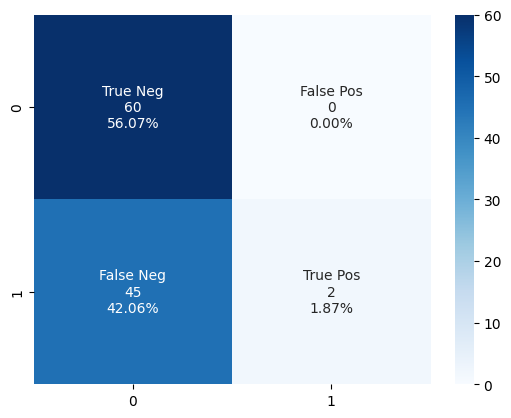

In [43]:
true_labels = y_test
predicted_labels = np.round(pred1)

print("Frame insertion dataset")

# Accuracy
accuracy = accuracy_score(true_labels, predicted_labels)
print("Accuracy:", accuracy)

# Precision
precision = precision_score(true_labels, predicted_labels)
print("Precision:", precision)

# Recall
recall = recall_score(true_labels, predicted_labels)
print("Recall:", recall)

# F1-score
f1 = f1_score(true_labels, predicted_labels)
print("F1-score:", f1)

# Confusion Matrix
conf_matrix = confusion_matrix(true_labels, predicted_labels)
print("Confusion Matrix:")
print(conf_matrix)
group_names = ["True Neg","False Pos","False Neg","True Pos"]
group_counts = ["{0:0.0f}".format(value) for value in
                conf_matrix.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in
                     conf_matrix.flatten()/np.sum(conf_matrix)]
labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in
          zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
sns.heatmap(conf_matrix, annot=labels, fmt='', cmap='Blues')


Frame deletion dataset
Accuracy: 1.0
Precision: 1.0
Recall: 1.0
F1-score: 1.0
Confusion Matrix:
[[60  0]
 [ 0 60]]
Confusion Matrix:
[[60  0]
 [ 0 60]]


<Axes: >

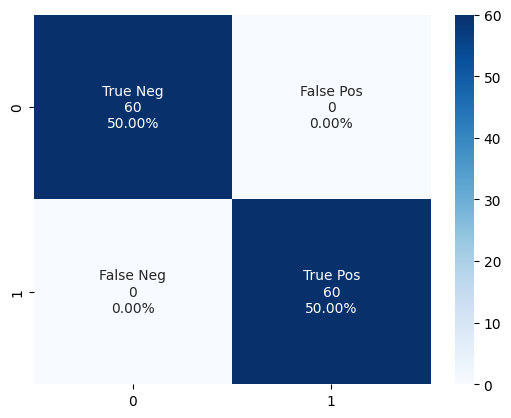

In [44]:
true_labels = y_test1
predicted_labels = np.round(pred2)

print("Frame deletion dataset")

# Accuracy
accuracy = accuracy_score(true_labels, predicted_labels)
print("Accuracy:", accuracy)

# Precision
precision = precision_score(true_labels, predicted_labels)
print("Precision:", precision)

# Recall
recall = recall_score(true_labels, predicted_labels)
print("Recall:", recall)

# F1-score
f1 = f1_score(true_labels, predicted_labels)
print("F1-score:", f1)

# Confusion Matrix
conf_matrix = confusion_matrix(true_labels, predicted_labels)
print("Confusion Matrix:")
print(conf_matrix)

group_names = ["True Neg","False Pos","False Neg","True Pos"]
group_counts = ["{0:0.0f}".format(value) for value in
                conf_matrix.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in
                     conf_matrix.flatten()/np.sum(conf_matrix)]
labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in
          zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
sns.heatmap(conf_matrix, annot=labels, fmt='', cmap='Blues')